# Seeing is Believing 
> 'Converting Audio Data into Images'

- author: Tony Chen, Dmytro Karabash, Hyeongchan Kim, Maxim Korotkov, 
- categories: [python, data science, neural networks]
- image: images/realnew3d.png
- permalink: /audio2images/
- hide: false

## Introduction

Close your eyes and listen to the sound around you. No matter whether you are in a crowded office, cozy home, or open space of nature, you can distinguish the environment with sound around you. One of the five major senses of humans is hearing, so audio plays a significant role in our life. Therefore, being able to organize and exploit values in audio data with deep learning is a crucial process for AI to understand our world. An important task in sound processing is enabling computers to distinguish one sound from another. This capability enables computers to do things ranging from detecting metal wearing in power plants to monitoring and optimizing fuel efficiency of cars. In this post, we will use bird sound identification as an example. We will detect locations of bird calls in recordings produced in natural settings and classify species. By converting audio data to image data and applying computer vision models, we acquired a silver medal (top 2%) in Kaggle Cornell Birdcall Identification challenge. 


## Treating Audios as Images

When a doctor diagnoses heart problems, he can either directly listen to the patient’s heartbeat or look at the ECG, a diagram that describes the heartbeat, of the patient. The former usually takes longer - it takes time for the doctor to listen - and harder - memorizing what you heard can be hard. In contrast, visual perceptions of ECG allows a doctor to absorb spatial information instantly and accelerates the tasks. 

The same rationales apply to our sound detection tasks. Here are four audio clips and corresponding spectrograms of four bird species. Even human eyes can see the differences between species instantly based on color and shapes.

![.](img-tony/4-bird-spectrogram.png)


In [2]:
import IPython.display as ipd
ipd.Audio('img-tony/amered.wav')

In [3]:
ipd.Audio('img-tony/cangoo.wav')

In [12]:
ipd.Audio('img-tony/haiwoo.wav')

In [13]:
ipd.Audio('img-tony/pingro.wav')

Going over the audio waves through time takes more computational resources, and we can acquire more information from the 2-dimensional data of images than 1-dimensional waves. In addition, the recent rapid development of computer visions, especially with the help of Convolutional Neural Network (CNNs), can significantly benefit our approach if treating audios as images as we (along with pretty much everyone) did in the competition. 

## Understanding Spectrogram

The specific image representation that we use is called a spectrogram: a visual representation of the spectrum of frequencies of a signal as it varies with time. 

Sounds can be represented in the forms of waves, and waves have two important properties: frequency and amplitude as illustrated in the picture below. The frequency determines how the audio sounds like, and amplitude determines how loud the sound is.

![img-tony/wave.png](img-tony/wave.png)

In a spectrogram of an audio clip, the horizontal direction represents time, and the vertical direction represents different frequencies. Finally, the amplitude of sounds of a particular frequency exists at a particular point of time is represented by the color of the point, resulting from the corresponding x-y coordinates. 

![img-tony/spectrogramex1.png](img-tony/spectrogramex1.png)

To more intuitively see how frequencies are embodied in spectrograms, here’s a 3D visualization, which demonstrates the amplitude with an extra dimension. Again, the x-axis is time, and y-axis is the value of frequencies. The z-axis is the amplitude of sounds of the frequency of y-coordinate at the moment of the x-coordinate. As the z-value increases, the color changes from blue to red, which results in the color we saw in the previous example of a 2D spectrogram.

![img-tony/realnew3d.png](img-tony/realnew3d.png)

Spectrograms are helpful because they extract exactly the information we need: frequencies, the features that shape the form of sound we hear. Different bird species, or actually all objects that produce sound, have their own unique frequency range so that their sounds appear to be different for our ears. Our model will simply need to master distinguishing between frequencies to achieve ideal classification results.

## Mel Scale and Mel Scale Spectrogram

However, human ears do not perceive differences in all frequency ranges equally. As frequencies increase, it is more difficult for us to distinguish between different frequencies. In order to better emulate human ear behaviors with deep learning models, we measure frequencies in mel scale. In the mel scale, any equal distance between frequencies sound equally different for human ears. mel scale converts frequency from in Hertz (f) to in mel (m) with the following equation:

<img src="img-tony/m_=_2595_times_l.jpg" alt="m_=_2595_times_l.jpg" width="200"/>


A mel scale spectrogram is simply a spectrogram with frequencies measured in mel.

## How do We Use Spectrogram?

To create a mel spectrogram from audio waves, we will employ librosa library.

In [14]:
import librosa
import numpy as np
y, sr = librosa.load('img-tony/amered.wav', sr=32000, mono=True)
melspec = librosa.feature.melspectrogram(y, sr=sr, n_mels = 128)
melspec = librosa.power_to_db(melspec).astype(np.float32)

Where y denotes the raw wave data, sr denotes sample rate of the audio sample, and n_mels decides the number of mel bands in the generated spectrogram. When using melspectrogram method, you can also set f_min and f_max method You can also set Then, we can convert mel spectrogram that express amplitude in amplitude squared scale to decibel scale with the power_to_db method.

To visualize the generated spectrogram, run

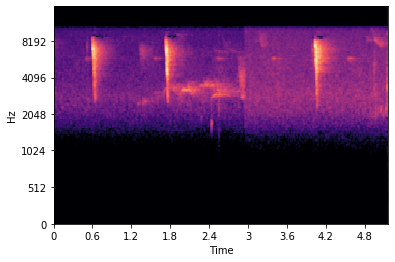

In [17]:
import librosa.display
librosa.display.specshow(melspec, x_axis='time',  y_axis='mel', sr=sr, fmax=16000)

Alternatively, if you are using GPU, you can accelerate the mel spectrogram generation process with torchlibrosa library.



In [16]:
is_gpu = False #For demonstration purpose, is_gpu is set to False. Change is_gpu to True when using torchlibrosa.
if is_gpu:
    from torchlibrosa.stft import Spectrogram, LogmelFilterBank

    spectrogram_extractor = Spectrogram()
    logmel_extractor = LogmelFilterBank()
    y = spectrogram_extractor(y)
    y = self.logmel_extractor(y)    

## Summary
In conclusion,we can take advantages from recent developments in computer vision in audio-related tasks by converting audio clips into image data. We achieve so with spectrograms that exhibit frequency, amplitude, and time information of audio data in an image. Using mel scale and mel scale spectrogram helps computers to emulate human hearing behaviors of distinguishing sounds of different frequencies. To generate spectrograms, we could employ librosa library, or torchlibrosa for GPU acceleration, in Python. By treating audio-related tasks in such a way, we are able to establish efficient deep learning models to identify and classify sounds, like how doctors diagnose heart-related diseases with ECG.
